In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import netCDF4 as nc
from datetime import datetime

from matplotlib.cm import ScalarMappable

from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors
from scipy.cluster.hierarchy import linkage
from scipy.spatial.distance import pdist
from sklearn.ensemble import IsolationForest


# 1.0 - Preparing The Data

This section of code will load in all the required data, bundling it into one dataframe. The section will then flatten the data to be ready for each of the models.

In [3]:
"""Some handy util funcs"""

def round25(temp):
    return round(temp * 4) / 4


In [4]:
#era5 dataset

dataframe = pd.read_csv('ibtracs.EP.list.v04r00.csv', low_memory=False).drop(0)
wp_data = dataframe[dataframe['BASIN'] == 'WP'] # only retain west pacific basin storms

In [5]:
"""
Function will combine temperature data (t2m) with track data, and return the new dataframe
"""
def get_temp_data(df):
    # load NetCDF temperature dataset
    t2m_data = nc.Dataset('t2m_data.nc')

    # the time data imported is in the format time since 1/1/1900
    ref_datetime = datetime(1900, 1, 1)

    # the new data we are appending
    t2m_vals = []
    formatted_lat_vals = []
    formatted_lon_vals = []

    # for each storm record
    for _, row in df.iterrows():
        # round lat and lon to the nearest 0.25 as this is how temp data is formatted
        lat = round25(float(row['LAT']))
        lon = round25(float(row['LON']))

        # extract month and year from time
        iso_time = datetime.strptime(row['ISO_TIME'], '%Y-%m-%d %H:%M:%S')
        month = iso_time.month
        year = iso_time.year

        # convert to hours since 1900, (same format as temp data)
        dt_formatted = datetime(year, month, 1)
        hours_since_1900 = (dt_formatted - ref_datetime).total_seconds() / 3600

        # get index values for corresponding t2m variables
        t2m_hours_index = np.abs(t2m_data.variables['time'][:] - hours_since_1900).argmin()
        t2m_lat_index = np.abs(t2m_data.variables['latitude'][:] - lat).argmin()
        t2m_lon_index = np.abs(t2m_data.variables['longitude'][:] - lon).argmin()

        # extract the 2m value using index values
        t2m = t2m_data.variables['t2m'][t2m_hours_index, t2m_lat_index, t2m_lon_index]

        # if valid append, otherwise None
        try:
            int(t2m)
            t2m_vals.append(t2m)
        except:
            t2m_vals.append(None)

        formatted_lat_vals.append(lat)
        formatted_lon_vals.append(lon)

    # put data into dataframe
    df.loc[:, 'T2M'] = t2m_vals
    df.loc[:, 'LAT_FORM'] = formatted_lat_vals
    df.loc[:, 'LON_FORM'] = formatted_lon_vals

    return df

In [6]:
wp_data = get_temp_data(wp_data)

C:\Users\david\AppData\Local\Temp\ipykernel_11000\617592232.py:50: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'T2M'] = t2m_vals
C:\Users\david\AppData\Local\Temp\ipykernel_11000\617592232.py:51: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'LAT_FORM'] = formatted_lat_vals
C:\Users\david\AppData\Local\Temp\ipykernel_11000\617592232.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


In [7]:
""" 
Selects X amount of equally spaced data points for a given storm
"""
def interpolate_points(storm_df, num_points):
    # generate an even range of indicies to take
    indices = np.linspace(0, len(storm_df) - 1, num_points)
    return storm_df.iloc[indices]

""" 
Iterates through all storms and iterpolates points from each
"""
def interpolate_all_storms(df, num_points):
    # group by SID and scrap any group that has less than 50 dps
    df = df.groupby('SID').filter(lambda group: len(group) >= 50)

    ids = df['SID'].drop_duplicates()

    interpolated_df = pd.DataFrame()

    for sid in ids:
        storm_data = df[df['SID'] == sid]
        interpoled_data = interpolate_points(storm_data, num_points)
        interpolated_df = interpolated_df.append(interpoled_data, ignore_index=True)
        
    return interpolated_df

In [8]:
wp_data = interpolate_all_storms(wp_data, 50)

C:\Users\david\AppData\Local\Temp\ipykernel_11000\3684483115.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  interpolated_df = interpolated_df.append(interpoled_data, ignore_index=True)


In [9]:
""" 
Calculate the hours since start forn each data point.
"""
def calculate_hss(df):
    ids = df['SID'].drop_duplicates()

    all_hss = []
    for sid in ids:
        storm_data = df[df['SID'] == sid]

        # get start time of storm
        start_time = datetime.strptime(storm_data.iloc[0]['ISO_TIME'], '%Y-%m-%d %H:%M:%S')
        for _, row in storm_data.iterrows():
            # get time of this point in storm
            this_time = datetime.strptime(row['ISO_TIME'], '%Y-%m-%d %H:%M:%S')

            # calculate difference in hours
            diff = this_time - start_time
            hours_diff = diff.total_seconds() / 3600
            all_hss.append(hours_diff)
            
    df.loc[:, 'HSS'] = all_hss
    return df

In [10]:
wp_data = calculate_hss(wp_data)

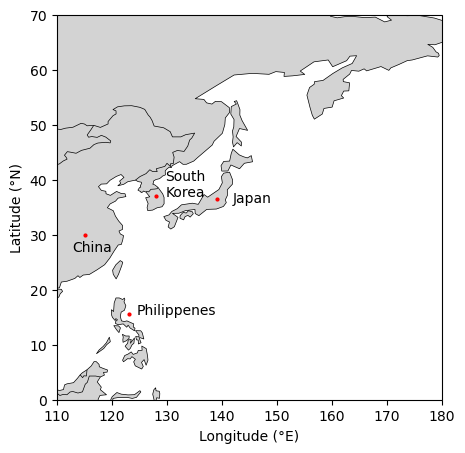

In [44]:
crs = ccrs.PlateCarree()

# create figure and axis
fig, ax = plt.subplots(1, 1, subplot_kw={'projection': crs}, figsize=(10, 5))
ax.add_feature(cfeature.LAND, facecolor='lightgray')
ax.add_feature(cfeature.COASTLINE, linewidth=0.5)
ax.add_feature(cfeature.BORDERS, linewidth=0.5)
ax.set_extent([110, 180, 0, 70], crs=crs)

ax.plot(139,36.5, 'ro', markersize=2)
ax.text(149, 36, 'Japan', color='black', fontsize=10, ha='right')

ax.plot(128, 37, 'ro', markersize=2)
ax.text(137, 37, 'South\nKorea', color='black', fontsize=10, ha='right')

ax.plot(115, 30, 'ro', markersize=2)
ax.text(120, 27, 'China', color='black', fontsize=10, ha='right')

ax.plot(123, 15.5, 'ro', markersize=2)
ax.text(139, 15.5, 'Philippenes', color='black', fontsize=10, ha='right')

# Manually set the ticks
ax.set_xticks(range(110, 181, 10))
ax.set_yticks(range(0, 71, 10))

ax.set_xlabel('Longitude (°E)')
ax.set_ylabel('Latitude (°N)')

plt.savefig('new_graphs/nwp.png', bbox_inches='tight', pad_inches=0.1, dpi=300)
plt.show()

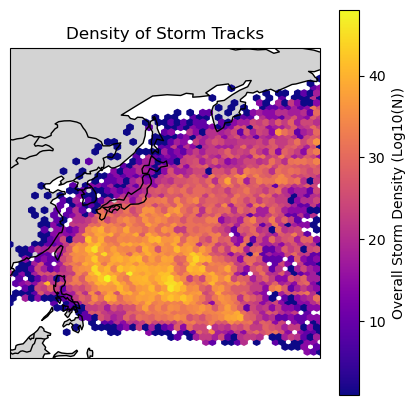

In [12]:
ids = wp_data['SID'].drop_duplicates()

crs = ccrs.PlateCarree()

# create figure and axis
fig, ax = plt.subplots(1, 1, subplot_kw={'projection': crs}, figsize=(5, 5))

ax.add_feature(cfeature.LAND, facecolor='lightgray')
ax.add_feature(cfeature.COASTLINE, linewidth=1, zorder=10, edgecolor='black')
ax.add_feature(cfeature.BORDERS, linewidth=1, zorder=10, edgecolor='black')
ax.set_extent([110, 180, 0, 70], crs=crs)

all_lats = []
all_lons = []

# loop through all unique ids (all storms)
for sid in ids:
    # get all data regarding this storm
    storm_data = wp_data[wp_data['SID'] == sid]

    for _, row in storm_data.iterrows():
        all_lats.append(float(row['LAT']))
        all_lons.append(float(row['LON']))

# plot the heatmap
hb = ax.hexbin(all_lons, all_lats, gridsize=50, cmap='plasma', bins='log', mincnt=1, zorder=5)

# configure colourbar with min and max of data
min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)
cbar = fig.colorbar(sm, ax=ax)
cbar.set_label('Overall Storm Density (Log10(N))')


plt.title('Density of Storm Tracks')
plt.savefig('graphs/tracks_density.png')
plt.show()

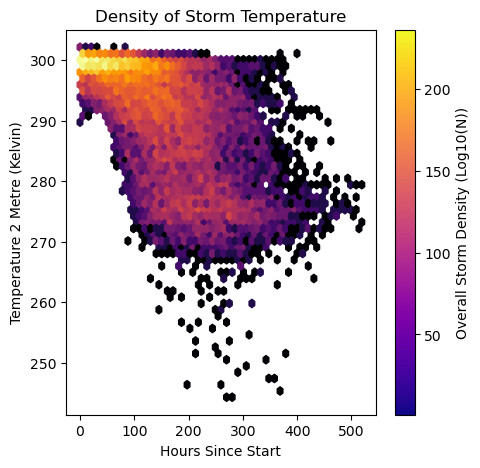

In [13]:
ids = wp_data['SID'].drop_duplicates()

# create figure and axis
fig, ax = plt.subplots(1, 1, figsize=(5, 5))

all_HSS = []
all_T2M = []

for id in ids:
    storm_data = wp_data[wp_data['SID'] == id]
    all_HSS.extend(storm_data['HSS'])
    all_T2M.extend(storm_data['T2M'])

# plot the heatmap
hb = ax.hexbin(all_HSS, all_T2M, gridsize=50, cmap='inferno', mincnt=1, bins='log')

# configure colourbar with min and max of data
min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)
cbar = fig.colorbar(sm, ax=ax)
cbar.set_label('Overall Storm Density (Log10(N))')

plt.title('Density of Storm Temperature')
ax.set_xlabel('Hours Since Start')
ax.set_ylabel('Temperature 2 Metre (Kelvin)')
plt.savefig('graphs/temperature_density.png')
plt.show()

In [14]:
"""
Take the df, and flatten it so that it can be processed by a model.

The resulting array will consist of one row for each storm, where each row consists of varying features:
    [lat1, lon1, t2m1, hss1, lat2, lon2, t2m2, hss2, ..., latX, lonX, t2mX, hssX]
"""
def flatten_data(df):
    flattened_data = np.array([])

    # loop over all storms
    for sid in df['SID'].drop_duplicates():
        this_data = np.array([])
        this_data = np.append(this_data, sid)

        # for each storm point...
        for _, row in df[df['SID'] == sid].iterrows():
            # ...extract data
            this_data = np.append(this_data, row['LAT_FORM'])
            this_data = np.append(this_data, row['LON_FORM'])
            this_data = np.append(this_data, row['T2M'])
            this_data = np.append(this_data, row['HSS'])

        if flattened_data.size == 0:
            flattened_data = this_data
        else:
            flattened_data = np.vstack((flattened_data, this_data))
            
    return flattened_data

In [15]:
wp_data_flattened = flatten_data(wp_data)

In [16]:
def get_model_score(model_results, index):
    for row in model_results:
        if row[0] == index:
            return row[1]
    return None

In [17]:
# get the data for each of the density heatmaps

all_lats = []
all_lons = []
all_HSS = []
all_T2M = []


ids = wp_data['SID'].drop_duplicates()
# loop through all unique ids (all storms)
for sid in ids:
    # get all data regarding this storm
    storm_data = wp_data[wp_data['SID'] == sid]

    for _, row in storm_data.iterrows():
        all_lats.append(float(row['LAT']))
        all_lons.append(float(row['LON']))
        all_HSS.append(row['HSS'])
        all_T2M.append(row['T2M'])

In [18]:
print(len(wp_data_flattened))
print(len(wp_data_flattened[0]))

storm_data = wp_data[wp_data['SID'] == wp_data_flattened[0][0]]
print(storm_data)

317
201
              SID SEASON NUMBER BASIN SUBBASIN      NAME             ISO_TIME  \
0   1946251N11165   1946     52    WP       MM  PRISCILL  1946-09-08 00:00:00   
1   1946251N11165   1946     52    WP       MM  PRISCILL  1946-09-08 03:00:00   
2   1946251N11165   1946     52    WP       MM  PRISCILL  1946-09-08 09:00:00   
3   1946251N11165   1946     52    WP       MM  PRISCILL  1946-09-08 15:00:00   
4   1946251N11165   1946     52    WP       MM  PRISCILL  1946-09-08 21:00:00   
5   1946251N11165   1946     52    WP       MM  PRISCILL  1946-09-09 03:00:00   
6   1946251N11165   1946     52    WP       MM  PRISCILL  1946-09-09 09:00:00   
7   1946251N11165   1946     52    WP       MM  PRISCILL  1946-09-09 15:00:00   
8   1946251N11165   1946     52    WP       MM  PRISCILL  1946-09-09 18:00:00   
9   1946251N11165   1946     52    WP       MM  PRISCILL  1946-09-10 00:00:00   
10  1946251N11165   1946     52    WP       MM  PRISCILL  1946-09-10 06:00:00   
11  1946251N11165   

# 2.1 - K Nearest Neighbour

This section will perform the K Nearest Neighbour algorithm on the data.

Here we have set k = 8. This is a moderate value. Due to the spatiotemporal nature, the data itself has quite a bit of variability, which a moderate to higher value of k can assist with. Smaller values of k might be too sensitive to the data

In [19]:
# normalise the data, excluding sid
scaler = StandardScaler()
data_normalized = scaler.fit_transform(wp_data_flattened[:, 1:])

# train the model to the data
knn = NearestNeighbors(n_neighbors=8)
knn.fit(data_normalized)

# get distances between each storm and its nearest neighbours
distances, indices = knn.kneighbors(data_normalized)

# compute mean distances for each storm and its neighbours (excluding itself)
mean_distances = np.mean(distances[:, 1:], axis=1)

# find all the distances in dataset, and pick a threshold based upon 95th percentile
percentile = 95
threshold = np.percentile(mean_distances, percentile)

# find anomalous storms where distance > theshold
knn_anomalous_indexes = []
knn_anomalous_distances = []

for i in range(len(mean_distances)):
    if mean_distances[i] > threshold:
        knn_anomalous_indexes.append([i, indices[i, 1:]])

        # round to 2 decimal places
        knn_anomalous_distances.append([i, round(mean_distances[i], 2)])

knn_anomalies = sorted([x[0] for x in knn_anomalous_indexes])
print('KNN Anomalies:', knn_anomalies)
print('Threshold:', threshold)
print('Mean Distance of Anomalies', np.mean([x[1] for x in knn_anomalous_distances]))

KNN Anomalies: [9, 48, 74, 79, 124, 137, 150, 155, 162, 170, 172, 179, 199, 227, 228, 310]
Threshold: 12.535680560093333
Mean Distance of Anomalies 14.33875


SID 1952224N14135, LABEL 9, METRIC 13.46, DATE 1952-08-10 12:00:00
SID 1960164N29134, LABEL 48, METRIC 13.31, DATE 1960-06-11 15:00:00
SID 1964224N25161, LABEL 74, METRIC 15.33, DATE 1964-08-10 18:00:00
SID 1965205N07163, LABEL 79, METRIC 12.82, DATE 1965-07-24 00:00:00
SID 1975221N18116, LABEL 124, METRIC 15.76, DATE 1975-08-09 06:00:00
SID 1978288N10185, LABEL 137, METRIC 13.5, DATE 1978-10-16 12:00:00
SID 1983239N10183, LABEL 150, METRIC 13.65, DATE 1983-08-27 15:00:00
SID 1984214N12143, LABEL 155, METRIC 15.22, DATE 1984-08-01 00:00:00
SID 1986221N17163, LABEL 162, METRIC 12.64, DATE 1986-08-09 00:00:00
SID 1989010N16212, LABEL 170, METRIC 17.26, DATE 1989-01-15 09:00:00
SID 1989235N26122, LABEL 172, METRIC 13.54, DATE 1989-08-22 18:00:00
SID 1990319N07197, LABEL 179, METRIC 13.46, DATE 1990-11-18 06:00:00
SID 1993221N12216, LABEL 199, METRIC 15.12, DATE 1993-08-19 21:00:00
SID 1997201N24152, LABEL 227, METRIC 13.0, DATE 1997-07-20 00:00:00
SID 1997221N03179, LABEL 228, METRIC 15.8

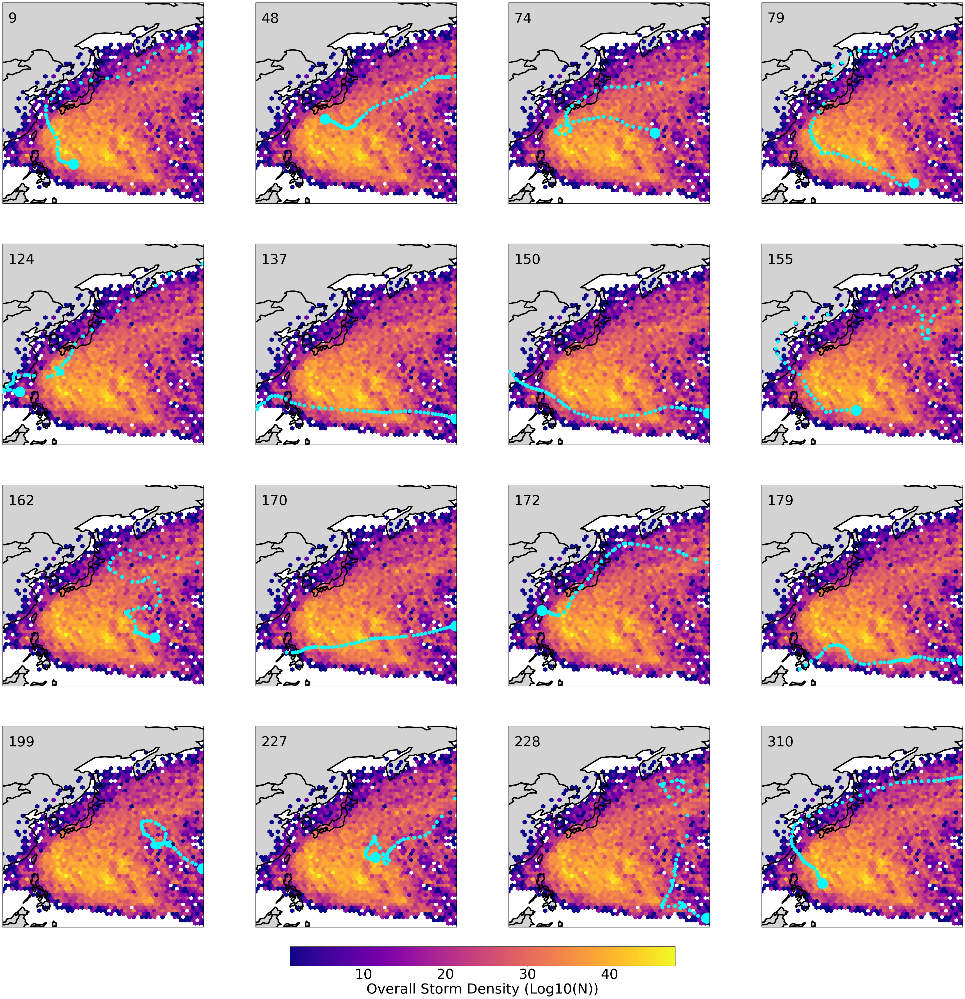

In [20]:
ids = wp_data['SID'].drop_duplicates()

# create figure and axis
crs = ccrs.PlateCarree()
fig, ax = plt.subplots(4, 4, subplot_kw={'projection': crs}, figsize=(50, 50))

for i in range(4):
    for j in range(4):
        # create 16 figures for each anomaly
        ax[i, j].add_feature(cfeature.LAND, facecolor='lightgray')
        ax[i, j].add_feature(cfeature.COASTLINE, linewidth=4, zorder=10, edgecolor='black')
        ax[i, j].add_feature(cfeature.BORDERS, linewidth=4, zorder=10, edgecolor='black')
        ax[i, j].set_extent([110, 180, 0, 70], crs=crs)   

        # plot density heatmap
        hb = ax[i, j].hexbin(all_lons, all_lats, gridsize=50, cmap='plasma', bins='log', mincnt=1, zorder=5)

        # get storm id and show storm label
        anomalous_label = knn_anomalies[i*4+j]
        anomolous_id = wp_data_flattened[anomalous_label][0]
        ax[i, j].text(112, 63, anomalous_label, fontsize=40)

        # get distance score of storm
        knn_distance = get_model_score(knn_anomalous_distances, anomalous_label)

        # get storm data
        storm_data = wp_data[wp_data['SID'] == anomolous_id]

        started = False
        print('SID {}, LABEL {}, METRIC {}, DATE {}'.format(anomolous_id, anomalous_label, knn_distance, storm_data.iloc[0]['ISO_TIME']))
        
        # loop through each storm point and plot
        for _, row in storm_data.iterrows():
            
            # make first point bigger
            if not started:
                marker_size = 30
                started = True
            else:
                marker_size = 10

            ax[i, j].plot(float(row['LON']), float(row['LAT']),color='cyan', marker='o', alpha=1, markersize=marker_size, zorder=15)

# configure colourbar with min and max of data
min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.02, pad=0.02)
cbar.set_label('Overall Storm Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

# show and save figure
plt.savefig('graphs/knn_anomalies_w_tracks_density.png', bbox_inches='tight', pad_inches=1)
plt.show()

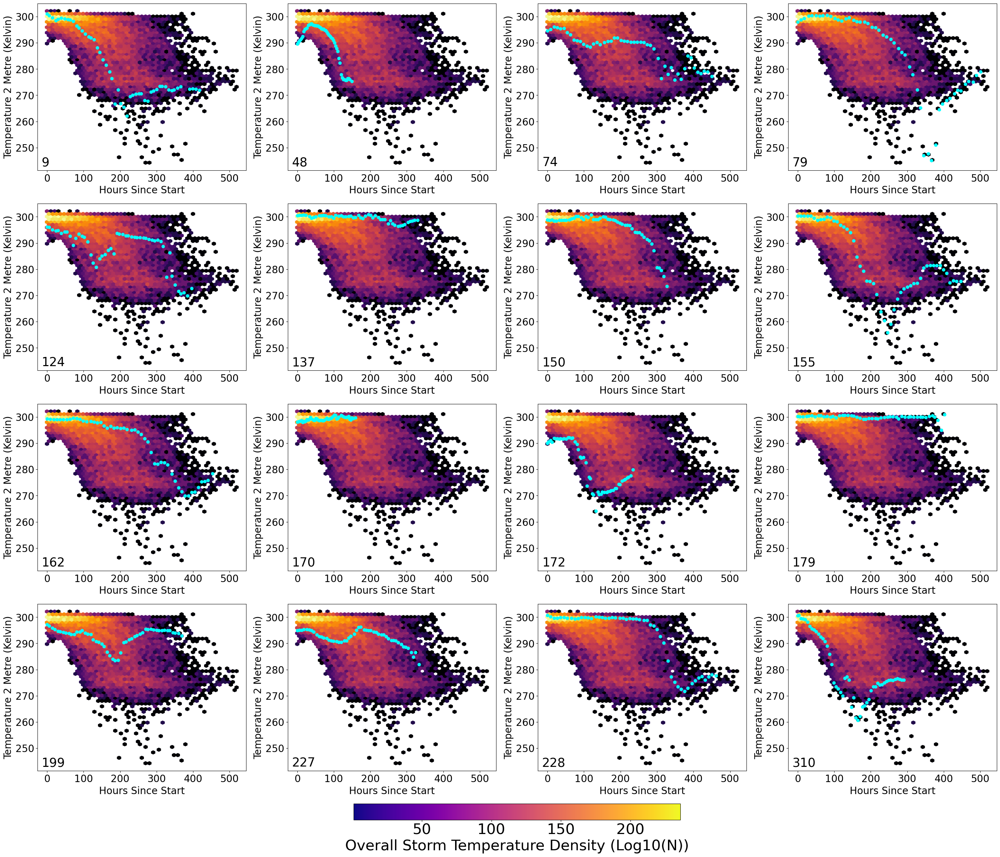

In [21]:
ids = wp_data['SID'].drop_duplicates()

# create figure and axis
fig, ax = plt.subplots(4, 4, figsize=(35, 30))

for i in range(4):
    for j in range(4):
        
        hb = ax[i, j].hexbin(all_HSS, all_T2M, gridsize=50, cmap='inferno', mincnt=1, bins='log')

        anomalous_label = knn_anomalies[i*4+j]
        anomolous_id = wp_data_flattened[anomalous_label][0]
        anomalous_storm_data = wp_data[wp_data['SID'] == anomolous_id]

        ax[i, j].scatter(anomalous_storm_data['HSS'], anomalous_storm_data['T2M'], color='cyan')
        ax[i, j].set_xlabel('Hours Since Start', fontsize=20)
        ax[i, j].set_ylabel('Temperature 2 Metre (Kelvin)', fontsize=20)
        ax[i, j].tick_params(axis='both', which='major', labelsize=20)

        ax[i, j].text(-15, 243, anomalous_label, fontsize=25)

min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.02, pad=0.04)
cbar.set_label('Overall Storm Temperature Density (Log10(N))', fontsize=30)
cbar.ax.tick_params(labelsize=30)

plt.savefig('graphs/knn_anomalies_w_temperature_density.png', bbox_inches='tight', pad_inches=1)
plt.show()

# 2.2 - Agglomerative Clustering

In [22]:
# normalise the data
scaler = StandardScaler()
data_normalized = scaler.fit_transform(wp_data_flattened[:, 1:])

# compute distances between each pair of points
distances = pdist(data_normalized)

# perform clustering on distances
Z = linkage(distances, method='ward')

# pick a threshold based upon 95th percentile
percentile = 95
threshold = np.percentile([row[2] for row in Z if row[0] < len(data_normalized) or row[1] < len(data_normalized)], percentile)

# find all distances which fall above theshold
anomalies = []
for i, row in enumerate(Z):
    if row[2] > threshold:
        anomalies.append([int(row[0]), int(row[2])])
        anomalies.append([int(row[1]), int(row[2])])

# remove duplicates and indexes that arent in dataset
ac_anomalous_indexes = [i for i in anomalies if i[0] < len(data_normalized)]

ac_anomalies = sorted([x[0] for x in ac_anomalous_indexes])
print('AC Anomalies:', ac_anomalies)

print('Threshold:', threshold)
print('Mean Distance of Anomalies', np.mean([x[1] for x in ac_anomalous_indexes]))

AC Anomalies: [48, 74, 124, 162, 170, 172, 199, 228, 235, 274, 295, 310]
Threshold: 12.632579666367105
Mean Distance of Anomalies 15.25


In [23]:
# normalise the data
scaler = StandardScaler()
data_normalized = scaler.fit_transform(wp_data_flattened[:, 1:])

# compute distances between each pair of points
distances = pdist(data_normalized)

# perform clustering on distances
Z = linkage(distances, method='average')

# pick a threshold based upon 95th percentile
percentile = 95
threshold = np.percentile([row[2] for row in Z if row[0] < len(data_normalized) or row[1] < len(data_normalized)], percentile)

# find all distances which fall above theshold
avg_anomalies = []
for i, row in enumerate(Z):
    if row[2] > threshold:
        avg_anomalies.append([int(row[0]), int(row[2])])
        avg_anomalies.append([int(row[1]), int(row[2])])

# remove duplicates and indexes that arent in dataset
ac_avg_anomalous_indexes = [i for i in avg_anomalies if i[0] < len(data_normalized)]

ac_avg_anomalies = sorted([x[0] for x in ac_avg_anomalous_indexes])
print('AC Anomalies:', ac_avg_anomalies)

print('Threshold:', threshold)
print('Mean Distance of Anomalies', np.mean([x[1] for x in ac_avg_anomalous_indexes]))

AC Anomalies: [48, 74, 124, 126, 162, 170, 172, 194, 228, 295, 310]
Threshold: 13.366736131601204
Mean Distance of Anomalies 15.727272727272727


SID 1960164N29134, LABEL 48, METRIC 16, DATE 1960-06-11 15:00:00
SID 1964224N25161, LABEL 74, METRIC 15, DATE 1964-08-10 18:00:00
SID 1975221N18116, LABEL 124, METRIC 15, DATE 1975-08-09 06:00:00
SID 1986221N17163, LABEL 162, METRIC 14, DATE 1986-08-09 00:00:00
SID 1989010N16212, LABEL 170, METRIC 19, DATE 1989-01-15 09:00:00
SID 1989235N26122, LABEL 172, METRIC 18, DATE 1989-08-22 18:00:00
SID 1993221N12216, LABEL 199, METRIC 13, DATE 1993-08-19 21:00:00
SID 1997221N03179, LABEL 228, METRIC 14, DATE 1997-08-09 06:00:00
SID 1998235N17131, LABEL 235, METRIC 13, DATE 1998-08-22 12:00:00
SID 2010240N15142, LABEL 274, METRIC 12, DATE 2010-08-27 18:00:00
SID 2015229N08212, LABEL 295, METRIC 16, DATE 2015-09-01 18:00:00
SID 2020213N15131, LABEL 310, METRIC 18, DATE 2020-07-30 18:00:00


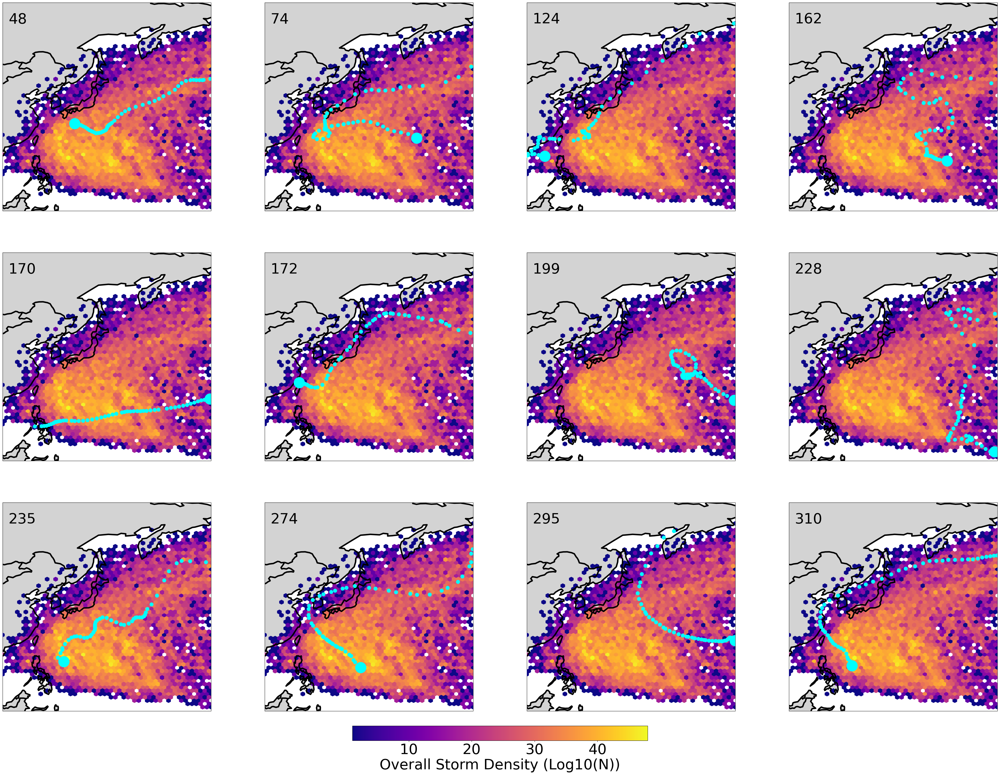

In [24]:
ids = wp_data['SID'].drop_duplicates()

crs = ccrs.PlateCarree()

# create figure and axis
fig, ax = plt.subplots(3, 4, subplot_kw={'projection': crs}, figsize=(50, 37))

for i in range(3):
    for j in range(4):
        ax[i, j].add_feature(cfeature.LAND, facecolor='lightgray')
        ax[i, j].add_feature(cfeature.COASTLINE, linewidth=4, zorder=10, edgecolor='black')
        ax[i, j].add_feature(cfeature.BORDERS, linewidth=4, zorder=10, edgecolor='black')
        ax[i, j].set_extent([110, 180, 0, 70], crs=crs)   

        hb = ax[i, j].hexbin(all_lons, all_lats, gridsize=50, cmap='plasma', bins='log', mincnt=1, zorder=5)

        storm_index = ac_anomalies[i*4+j]
        anomolous_id = wp_data_flattened[storm_index][0]

        ax[i, j].text(112, 63, storm_index, fontsize=40)

        ac_distance = get_model_score(ac_anomalous_indexes, storm_index)

        storm_data = wp_data[wp_data['SID'] == anomolous_id]

        started = False

        print('SID {}, LABEL {}, METRIC {}, DATE {}'.format(anomolous_id, storm_index, ac_distance, storm_data.iloc[0]['ISO_TIME']))
        
        for _, row in storm_data.iterrows():

            if not started:
                marker_size = 30
                started = True
            else:
                marker_size = 10

            ax[i, j].plot(float(row['LON']), float(row['LAT']),color='cyan', marker='o', alpha=1, markersize=marker_size, zorder=15)

min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.02, pad=0.02)
cbar.set_label('Overall Storm Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

plt.savefig('graphs/ac_anomalies_w_tracks_density.png', bbox_inches='tight', pad_inches=1)
plt.show()

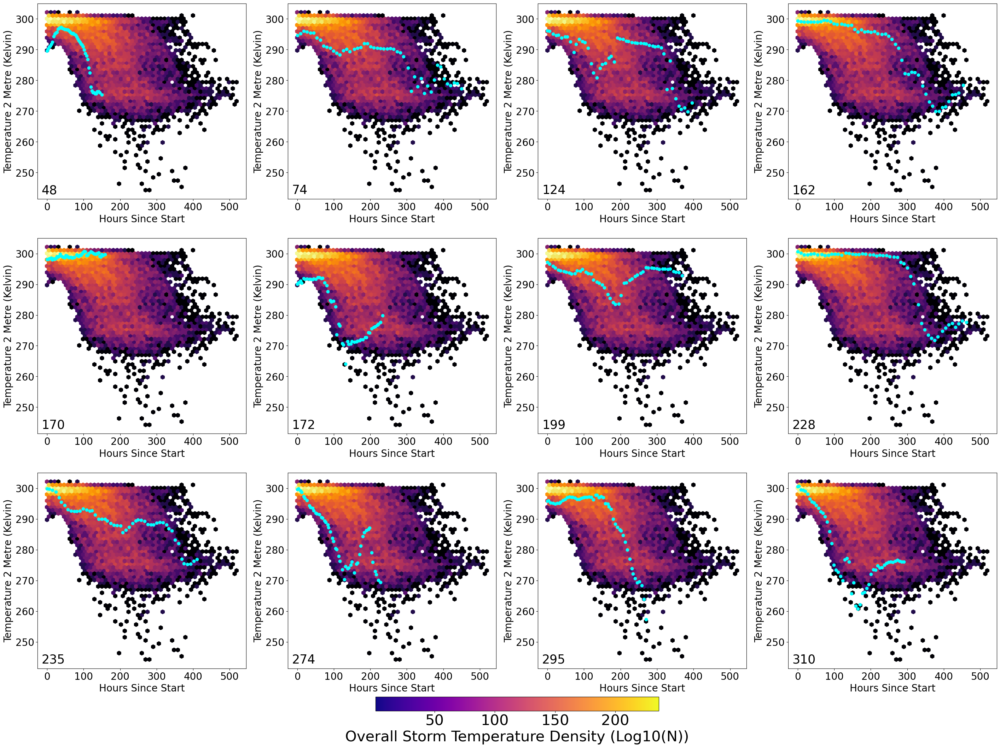

In [25]:
ids = wp_data['SID'].drop_duplicates()

# create figure and axis
fig, ax = plt.subplots(3, 4, figsize=(35, 26))

for i in range(3):
    for j in range(4):
        
        hb = ax[i, j].hexbin(all_HSS, all_T2M, gridsize=50, cmap='inferno', mincnt=1, bins='log')

        anomalous_index = ac_anomalies[i*4+j]
        anomolous_id = wp_data_flattened[anomalous_index][0]
        anomalous_storm_data = wp_data[wp_data['SID'] == anomolous_id]
        ax[i, j].scatter(anomalous_storm_data['HSS'], anomalous_storm_data['T2M'], color='cyan')
        ax[i, j].set_xlabel('Hours Since Start', fontsize=20)
        ax[i, j].set_ylabel('Temperature 2 Metre (Kelvin)', fontsize=20)
        ax[i, j].tick_params(axis='both', which='major', labelsize=20)

        ax[i, j].text(-15, 243, anomalous_index, fontsize=25)

min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.02, pad=0.04)
cbar.set_label('Overall Storm Temperature Density (Log10(N))', fontsize=30)
cbar.ax.tick_params(labelsize=30)

plt.savefig('graphs/ac_anomalies_w_temperature_density.png', bbox_inches='tight', pad_inches=1)
plt.show()

# 2.3 - Isolation Forest

In [26]:
"""
forest.decision_function gives scores between [-0.5, 0.5], where lower scores identify anomalies. 
This function converts to a [0, 1] scale where higher scores identify anomalies.
"""
def convert_scores(scores):
    return (scores - scores.min()) / (scores.max() - scores.min())

In [27]:
# normalise the data
scaler = StandardScaler()
data_normalized = scaler.fit_transform(wp_data_flattened[:, 1:])

# fit the data
rng = np.random.RandomState(64)
forest = IsolationForest(random_state=rng, bootstrap=True, n_estimators=150) #max_samples dflt = auto, max_features dflt=1.0
forest.fit(data_normalized)

# get anomaly scores
scores = convert_scores(forest.decision_function(data_normalized))

# set threshold to 5 (95th percentile of anomalies)
threshold = np.percentile(scores, 5)
score_checks = scores < threshold

if_anomalous_indexes = []
for i in range(len(score_checks)):
    if score_checks[i]:
        if_anomalous_indexes.append([i, round((1- scores[i]) * 100)]) # convert score to rounded %

if_anomalies = sorted([x[0] for x in if_anomalous_indexes])
print('IF Anomalies:', if_anomalies)
print('Threshold:', 1-threshold)
print('Mean Distance of Anomalies', np.mean([x[1] for x in if_anomalous_indexes]))

IF Anomalies: [9, 17, 74, 79, 124, 155, 170, 172, 179, 197, 199, 217, 218, 228, 310, 313]
Threshold: 0.8025391660998266
Mean Distance of Anomalies 89.5625


SID 1952224N14135, LABEL 9, METRIC 100, DATE 1952-08-10 12:00:00
SID 1954240N13151, LABEL 17, METRIC 85, DATE 1954-08-28 00:00:00
SID 1964224N25161, LABEL 74, METRIC 86, DATE 1964-08-10 18:00:00
SID 1965205N07163, LABEL 79, METRIC 90, DATE 1965-07-24 00:00:00
SID 1975221N18116, LABEL 124, METRIC 89, DATE 1975-08-09 06:00:00
SID 1984214N12143, LABEL 155, METRIC 95, DATE 1984-08-01 00:00:00
SID 1989010N16212, LABEL 170, METRIC 96, DATE 1989-01-15 09:00:00
SID 1989235N26122, LABEL 172, METRIC 91, DATE 1989-08-22 18:00:00
SID 1990319N07197, LABEL 179, METRIC 87, DATE 1990-11-18 06:00:00
SID 1992318N06182, LABEL 197, METRIC 81, DATE 1992-11-13 21:00:00
SID 1993221N12216, LABEL 199, METRIC 97, DATE 1993-08-19 21:00:00
SID 1996210N05156, LABEL 217, METRIC 95, DATE 1996-07-28 00:00:00
SID 1996227N15176, LABEL 218, METRIC 84, DATE 1996-08-14 00:00:00
SID 1997221N03179, LABEL 228, METRIC 87, DATE 1997-08-09 06:00:00
SID 2020213N15131, LABEL 310, METRIC 81, DATE 2020-07-30 18:00:00
SID 2021219N08

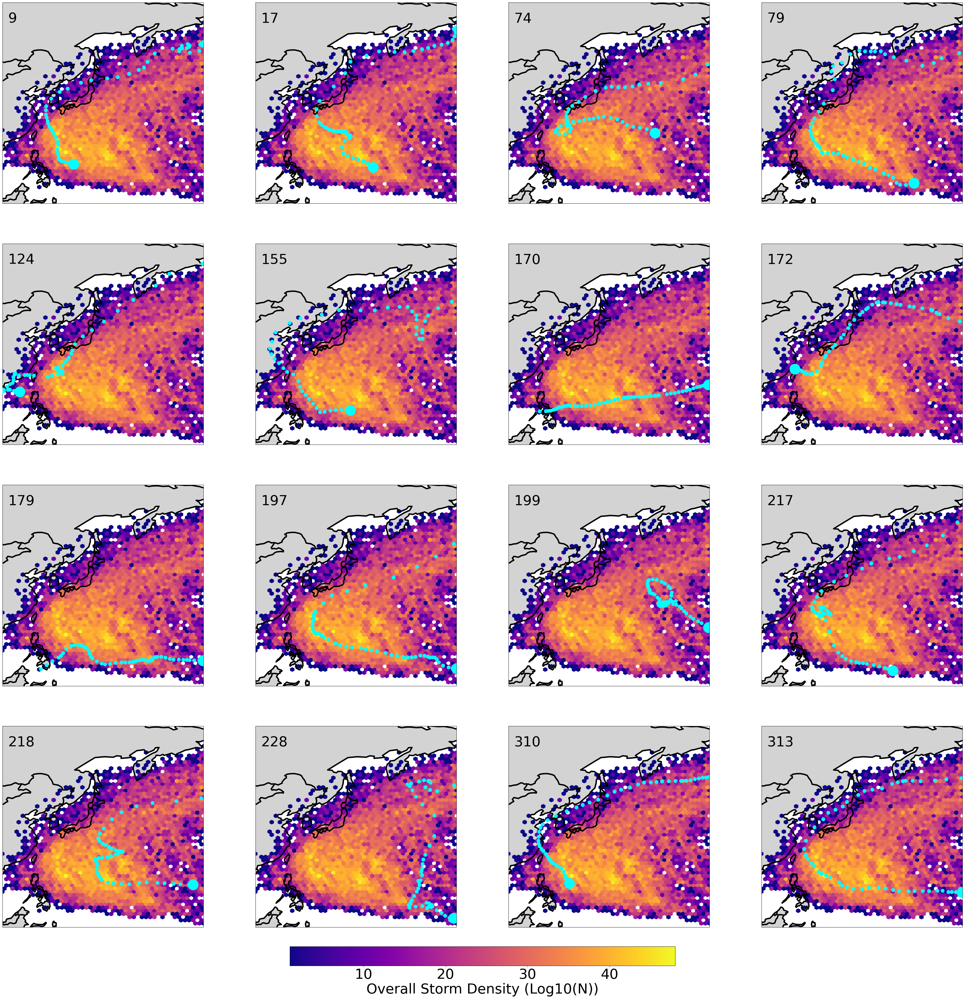

In [28]:
ids = wp_data['SID'].drop_duplicates()

crs = ccrs.PlateCarree()

# create figure and axis
fig, ax = plt.subplots(4, 4, subplot_kw={'projection': crs}, figsize=(50, 50))

for i in range(4):
    for j in range(4):
        ax[i, j].add_feature(cfeature.LAND, facecolor='lightgray')
        ax[i, j].add_feature(cfeature.COASTLINE, linewidth=4, zorder=10, edgecolor='black')
        ax[i, j].add_feature(cfeature.BORDERS, linewidth=4, zorder=10, edgecolor='black')
        ax[i, j].set_extent([110, 180, 0, 70], crs=crs)   

        hb = ax[i, j].hexbin(all_lons, all_lats, gridsize=50, cmap='plasma', bins='log', mincnt=1, zorder=5)

        anomalous_index = if_anomalies[i*4+j]
        anomolous_id = wp_data_flattened[anomalous_index][0]

        ax[i, j].text(112, 63, anomalous_index, fontsize=40)

        if_score = get_model_score(if_anomalous_indexes, anomalous_index)

        storm_data = wp_data[wp_data['SID'] == anomolous_id]

        started = False

        print('SID {}, LABEL {}, METRIC {}, DATE {}'.format(anomolous_id, anomalous_index, if_score, storm_data.iloc[0]['ISO_TIME']))
        
        for _, row in storm_data.iterrows():

            if not started:
                marker_size = 30
                started = True
            else:
                marker_size = 10

            ax[i, j].plot(float(row['LON']), float(row['LAT']),color='cyan', marker='o', alpha=1, markersize=marker_size, zorder=15)

min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.02, pad=0.02)
cbar.set_label('Overall Storm Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

plt.savefig('graphs/if_anomalies_w_tracks_density.png', bbox_inches='tight', pad_inches=1)
plt.show()

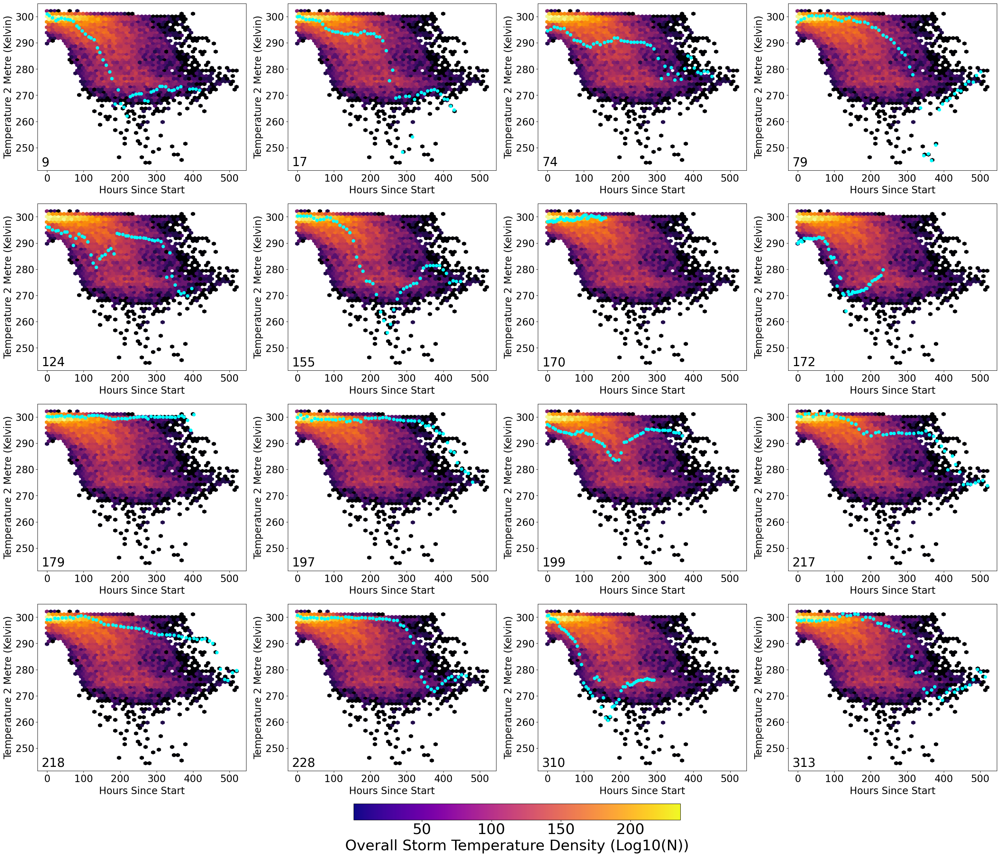

In [29]:
ids = wp_data['SID'].drop_duplicates()

# create figure and axis
fig, ax = plt.subplots(4, 4, figsize=(35, 30))

for i in range(4):
    for j in range(4):

        hb = ax[i, j].hexbin(all_HSS, all_T2M, gridsize=50, cmap='inferno', mincnt=1, bins='log')

        anomalous_label = if_anomalies[i*4+j]
        anomolous_id = wp_data_flattened[anomalous_label][0]
        anomalous_storm_data = wp_data[wp_data['SID'] == anomolous_id]
        ax[i, j].scatter(anomalous_storm_data['HSS'], anomalous_storm_data['T2M'], color='cyan')
        ax[i, j].set_xlabel('Hours Since Start', fontsize=20)
        ax[i, j].set_ylabel('Temperature 2 Metre (Kelvin)', fontsize=20)
        ax[i, j].tick_params(axis='both', which='major', labelsize=20)

        ax[i, j].text(-15, 243, anomalous_label, fontsize=25)

min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.02, pad=0.04)
cbar.set_label('Overall Storm Temperature Density (Log10(N))', fontsize=30)
cbar.ax.tick_params(labelsize=30)

plt.savefig('graphs/if_anomalies_w_temperature_density.png', bbox_inches='tight', pad_inches=1)
plt.show()

# Further Graphs and Figures For Analysis

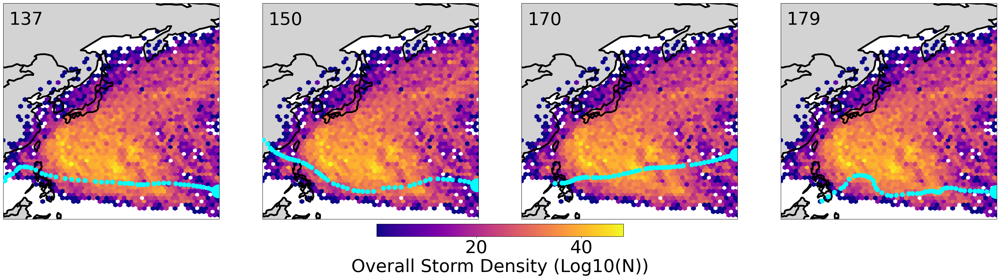

In [53]:
ids = wp_data['SID'].drop_duplicates()

crs = ccrs.PlateCarree()

# create figure and axis
fig, ax = plt.subplots(1, 4, subplot_kw={'projection': crs}, figsize=(40, 10))

storms_to_show = [137, 150, 170, 179]

for i in range(len(storms_to_show)):
    ax[i].add_feature(cfeature.LAND, facecolor='lightgray')
    ax[i].add_feature(cfeature.COASTLINE, linewidth=4, zorder=10, edgecolor='black')
    ax[i].add_feature(cfeature.BORDERS, linewidth=4, zorder=10, edgecolor='black')
    ax[i].set_extent([110, 180, 0, 70], crs=crs)   

    hb = ax[i].hexbin(all_lons, all_lats, gridsize=50, cmap='plasma', bins='log', mincnt=1, zorder=5)

    anomalous_index = storms_to_show[i]
    anomolous_id = wp_data_flattened[anomalous_index][0]

    ax[i].text(112, 63, anomalous_index, fontsize=40)

    storm_data = wp_data[wp_data['SID'] == anomolous_id]

    started = False

    for _, row in storm_data.iterrows():

        if not started:
            marker_size = 30
            started = True
        else:
            marker_size = 10

        ax[i].plot(float(row['LON']), float(row['LAT']),color='cyan', marker='o', alpha=1, markersize=marker_size, zorder=15)

min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.05, pad=0.02)
cbar.set_label('Overall Storm Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

plt.savefig('new_graphs/137_150_170_179_track.png', bbox_inches='tight', pad_inches=1, dpi=300)
plt.show()

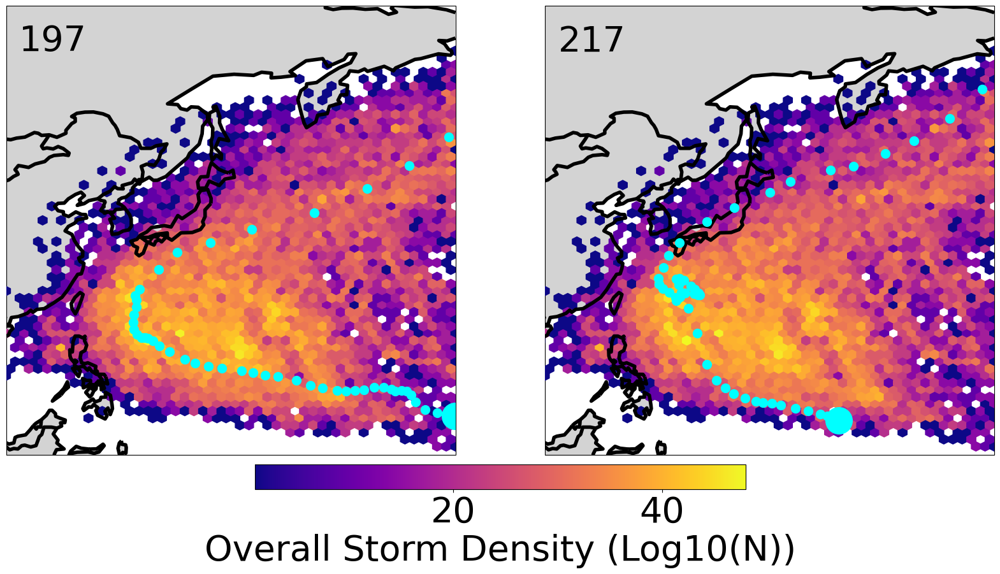

In [57]:
ids = wp_data['SID'].drop_duplicates()

crs = ccrs.PlateCarree()

# create figure and axis
fig, ax = plt.subplots(1, 2, subplot_kw={'projection': crs}, figsize=(20, 10))

storms_to_show = [197, 217]

for i in range(len(storms_to_show)):
    ax[i].add_feature(cfeature.LAND, facecolor='lightgray')
    ax[i].add_feature(cfeature.COASTLINE, linewidth=4, zorder=10, edgecolor='black')
    ax[i].add_feature(cfeature.BORDERS, linewidth=4, zorder=10, edgecolor='black')
    ax[i].set_extent([110, 180, 0, 70], crs=crs)   

    hb = ax[i].hexbin(all_lons, all_lats, gridsize=50, cmap='plasma', bins='log', mincnt=1, zorder=5)

    anomalous_index = storms_to_show[i]
    anomolous_id = wp_data_flattened[anomalous_index][0]

    ax[i].text(112, 63, anomalous_index, fontsize=40)

    storm_data = wp_data[wp_data['SID'] == anomolous_id]

    started = False

        
    for _, row in storm_data.iterrows():

        if not started:
            marker_size = 30
            started = True
        else:
            marker_size = 10

        ax[i].plot(float(row['LON']), float(row['LAT']),color='cyan', marker='o', alpha=1, markersize=marker_size, zorder=15)

min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.05, pad=0.02)
cbar.set_label('Overall Storm Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

plt.savefig('new_graphs/197_217_track.png', bbox_inches='tight', pad_inches=1, dpi=300)
plt.show()

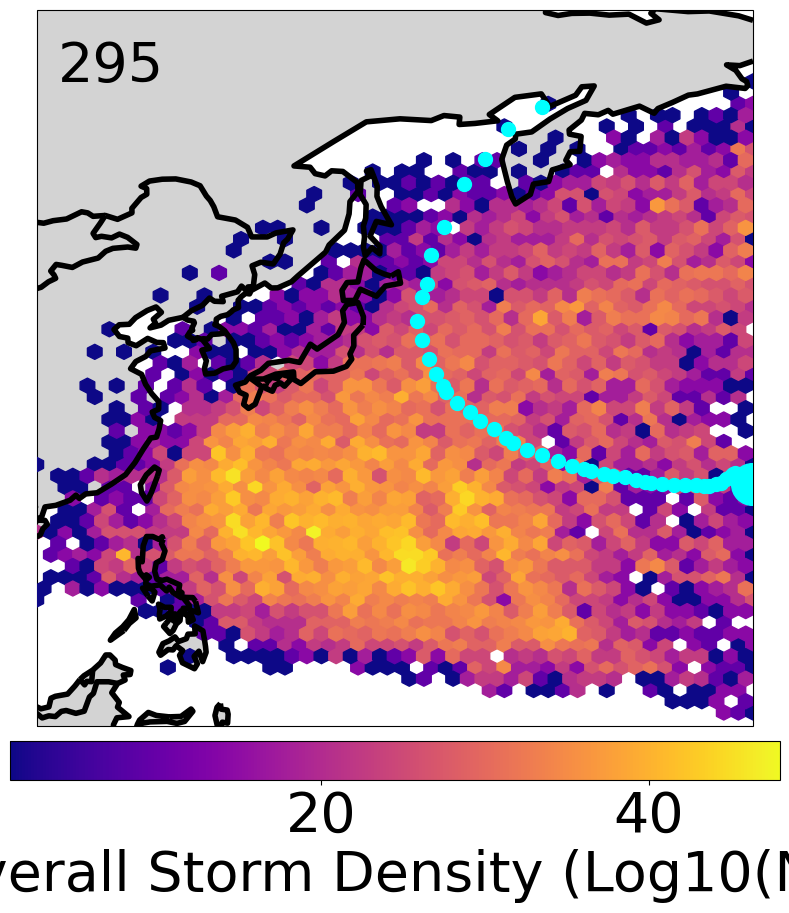

In [56]:
ids = wp_data['SID'].drop_duplicates()

crs = ccrs.PlateCarree()

# create figure and axis
fig, ax = plt.subplots(1, 1, subplot_kw={'projection': crs}, figsize=(10, 10))

storms_to_show = [295]

for i in range(len(storms_to_show)):
    ax.add_feature(cfeature.LAND, facecolor='lightgray')
    ax.add_feature(cfeature.COASTLINE, linewidth=4, zorder=10, edgecolor='black')
    ax.add_feature(cfeature.BORDERS, linewidth=4, zorder=10, edgecolor='black')
    ax.set_extent([110, 180, 0, 70], crs=crs)   

    hb = ax.hexbin(all_lons, all_lats, gridsize=50, cmap='plasma', bins='log', mincnt=1, zorder=5)

    anomalous_index = storms_to_show[i]
    anomolous_id = wp_data_flattened[anomalous_index][0]

    ax.text(112, 63, anomalous_index, fontsize=40)

    storm_data = wp_data[wp_data['SID'] == anomolous_id]

    started = False
    
    for _, row in storm_data.iterrows():

        if not started:
            marker_size = 30
            started = True
        else:
            marker_size = 10

        ax.plot(float(row['LON']), float(row['LAT']), color='cyan', marker='o', alpha=1, markersize=marker_size, zorder=15)

min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.05, pad=0.02)
cbar.set_label('Overall Storm Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

plt.savefig('new_graphs/295_track.png', bbox_inches='tight', pad_inches=1, dpi=300)
plt.show()

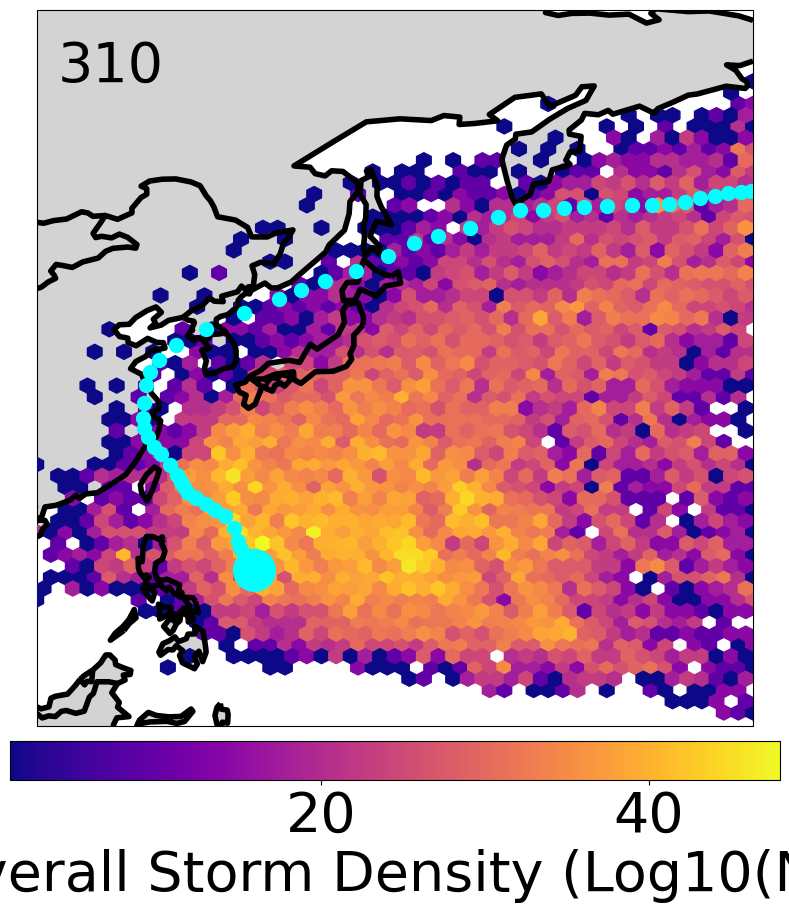

In [54]:
ids = wp_data['SID'].drop_duplicates()

crs = ccrs.PlateCarree()

# create figure and axis
fig, ax = plt.subplots(1, 1, subplot_kw={'projection': crs}, figsize=(10, 10))

storms_to_show = [310]

for i in range(len(storms_to_show)):
    ax.add_feature(cfeature.LAND, facecolor='lightgray')
    ax.add_feature(cfeature.COASTLINE, linewidth=4, zorder=10, edgecolor='black')
    ax.add_feature(cfeature.BORDERS, linewidth=4, zorder=10, edgecolor='black')
    ax.set_extent([110, 180, 0, 70], crs=crs)   

    hb = ax.hexbin(all_lons, all_lats, gridsize=50, cmap='plasma', bins='log', mincnt=1, zorder=5)

    anomalous_index = storms_to_show[i]
    anomolous_id = wp_data_flattened[anomalous_index][0]

    ax.text(112, 63, anomalous_index, fontsize=40)

    storm_data = wp_data[wp_data['SID'] == anomolous_id]

    started = False
    
    for _, row in storm_data.iterrows():

        if not started:
            marker_size = 30
            started = True
        else:
            marker_size = 10

        ax.plot(float(row['LON']), float(row['LAT']), color='cyan', marker='o', alpha=1, markersize=marker_size, zorder=15)

min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.05, pad=0.02)
cbar.set_label('Overall Storm Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

plt.savefig('new_graphs/310_track.png', bbox_inches='tight', pad_inches=1, dpi=300)
plt.show()

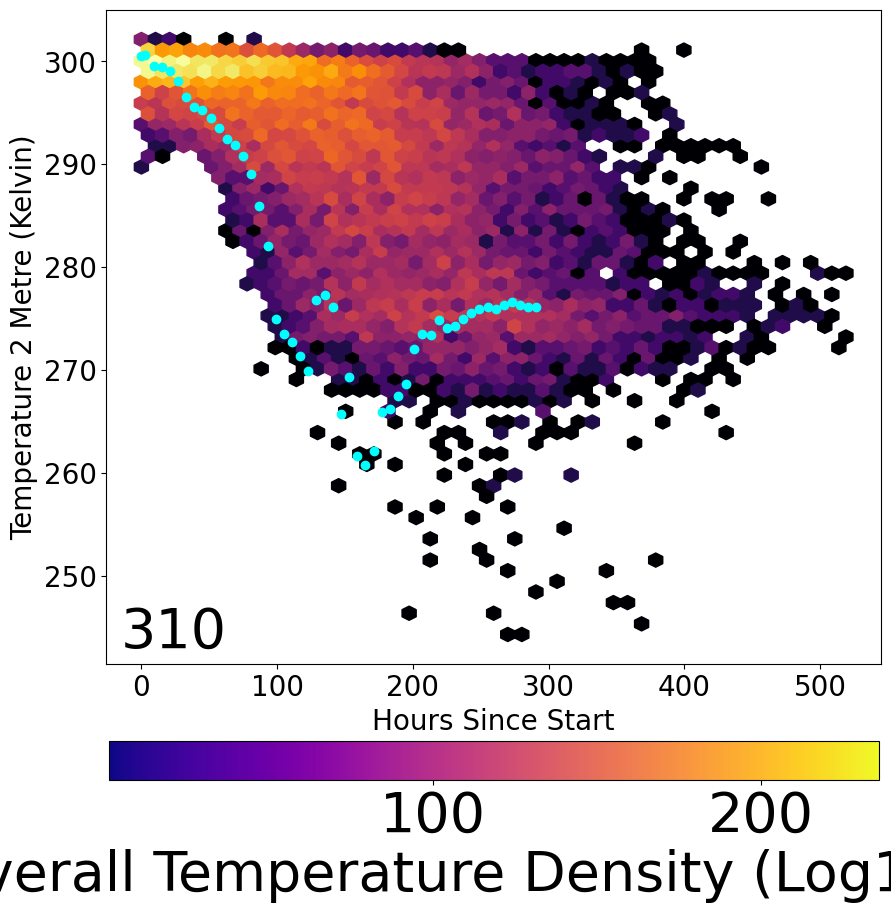

In [55]:
ids = wp_data['SID'].drop_duplicates()

# create figure and axis
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

storms_to_show = [310]

for i in range(len(storms_to_show)):
    
    hb = ax.hexbin(all_HSS, all_T2M, gridsize=50, cmap='inferno', mincnt=1, bins='log')

    anomalous_index = storms_to_show[i]
    anomolous_id = wp_data_flattened[anomalous_index][0]
    
    storm_data = wp_data[wp_data['SID'] == anomolous_id]

    ax.scatter(storm_data['HSS'], storm_data['T2M'], color='cyan')
    ax.set_xlabel('Hours Since Start', fontsize=20)
    ax.set_ylabel('Temperature 2 Metre (Kelvin)', fontsize=20)
    ax.tick_params(axis='both', which='major', labelsize=20)

    ax.text(-15, 243, anomalous_index, fontsize=40)
    
min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.05, pad=0.1)
cbar.set_label('Overall Temperature Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

plt.savefig('new_graphs/310_temp.png', bbox_inches='tight', pad_inches=2, dpi=300)
plt.show()

# CONDENSED GRAPHS

# KNN

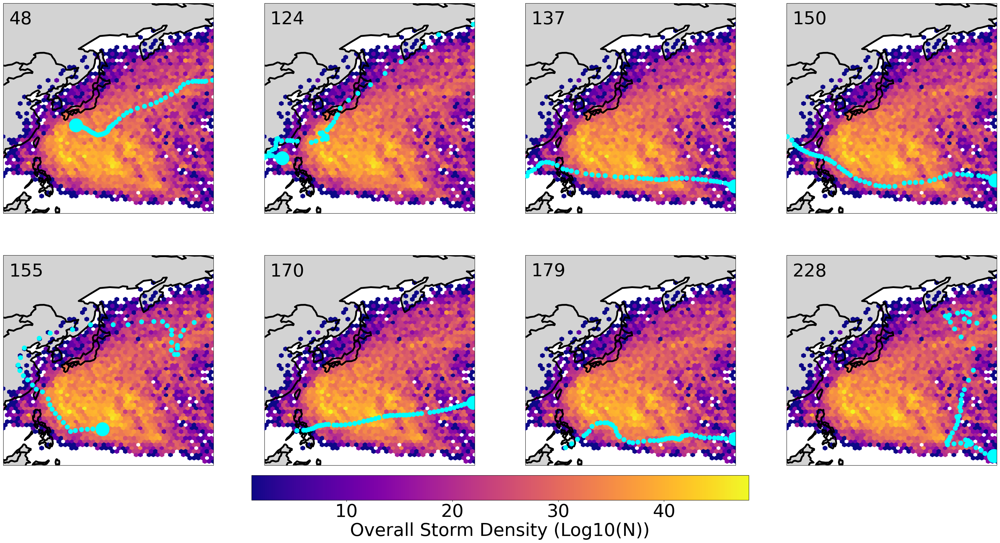

In [47]:
ids = wp_data['SID'].drop_duplicates()

crs = ccrs.PlateCarree()

# create figure and axis
fig, ax = plt.subplots(2, 4, subplot_kw={'projection': crs}, figsize=(40, 20))

storms_to_show = [[48, 124, 137, 150], [155, 170, 179, 228]]

for i in range(len(storms_to_show)):
    for j in range(len(storms_to_show[i])):
        ax[i, j].add_feature(cfeature.LAND, facecolor='lightgray')
        ax[i, j].add_feature(cfeature.COASTLINE, linewidth=4, zorder=10, edgecolor='black')
        ax[i, j].add_feature(cfeature.BORDERS, linewidth=4, zorder=10, edgecolor='black')
        ax[i, j].set_extent([110, 180, 0, 70], crs=crs)   

        hb = ax[i, j].hexbin(all_lons, all_lats, gridsize=50, cmap='plasma', bins='log', mincnt=1, zorder=5)

        anomalous_index = storms_to_show[i][j]
        anomolous_id = wp_data_flattened[anomalous_index][0]

        ax[i, j].text(112, 63, anomalous_index, fontsize=40)

        storm_data = wp_data[wp_data['SID'] == anomolous_id]

        started = False
        
        for _, row in storm_data.iterrows():

            if not started:
                marker_size = 30
                started = True
            else:
                marker_size = 10

            ax[i, j].plot(float(row['LON']), float(row['LAT']), color='cyan', marker='o', alpha=1, markersize=marker_size, zorder=15)

min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.05, pad=0.02)
cbar.set_label('Overall Storm Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

plt.savefig('new_graphs/knn_track.png', bbox_inches='tight', pad_inches=1, dpi=300)
plt.show()

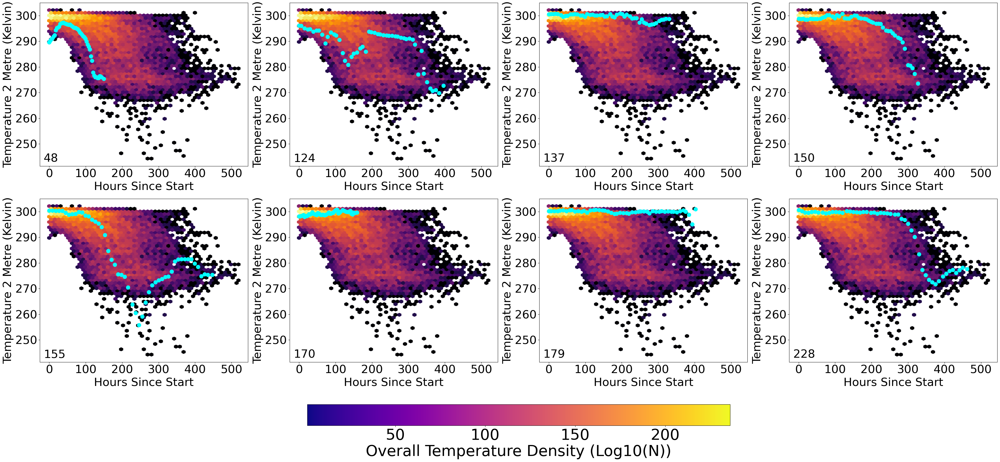

In [48]:
ids = wp_data['SID'].drop_duplicates()

# create figure and axis
fig, ax = plt.subplots(2, 4, figsize=(45, 20))

storms_to_show = [[48, 124, 137, 150], [155, 170, 179, 228]]

for i in range(len(storms_to_show)):
    for j in range(len(storms_to_show[i])):
    
        hb = ax[i, j].hexbin(all_HSS, all_T2M, gridsize=50, cmap='inferno', mincnt=1, bins='log')

        anomalous_index = storms_to_show[i][j]
        anomolous_id = wp_data_flattened[anomalous_index][0]
        
        storm_data = wp_data[wp_data['SID'] == anomolous_id]

        ax[i, j].scatter(storm_data['HSS'], storm_data['T2M'], color='cyan', s=100)
        ax[i, j].set_xlabel('Hours Since Start', fontsize=30)
        ax[i, j].set_ylabel('Temperature 2 Metre (Kelvin)', fontsize=30)
        ax[i, j].tick_params(axis='both', which='major', labelsize=30)

        ax[i, j].text(-15, 243, anomalous_index, fontsize=30)
    
min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.05, pad=0.1)
cbar.set_label('Overall Temperature Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

plt.savefig('new_graphs/knn_temp.png', bbox_inches='tight', pad_inches=1, dpi=300)
plt.show()

# AC

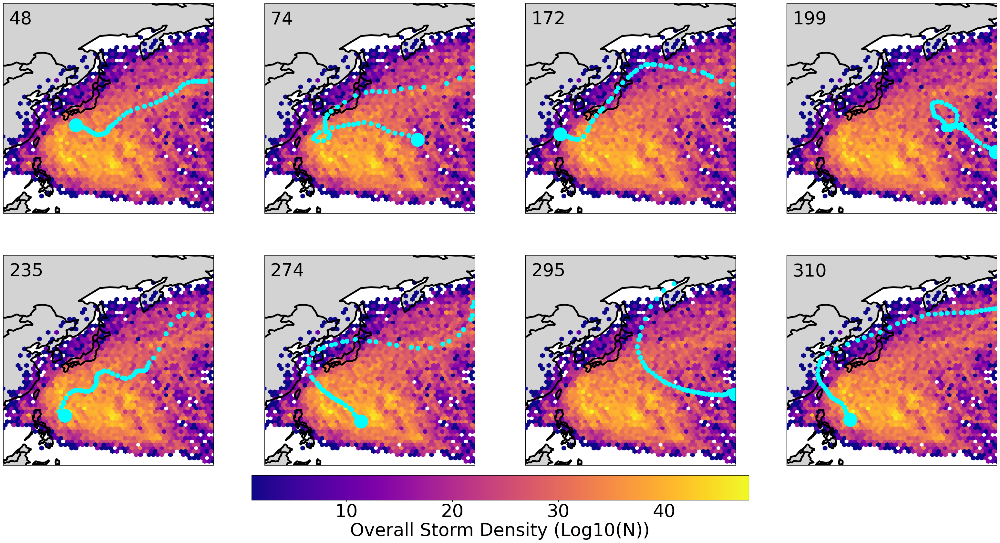

In [49]:
ids = wp_data['SID'].drop_duplicates()

crs = ccrs.PlateCarree()

# create figure and axis
fig, ax = plt.subplots(2, 4, subplot_kw={'projection': crs}, figsize=(40, 20))

storms_to_show = [[48, 74, 172, 199], [235, 274, 295, 310]]

for i in range(len(storms_to_show)):
    for j in range(len(storms_to_show[i])):
        ax[i, j].add_feature(cfeature.LAND, facecolor='lightgray')
        ax[i, j].add_feature(cfeature.COASTLINE, linewidth=4, zorder=10, edgecolor='black')
        ax[i, j].add_feature(cfeature.BORDERS, linewidth=4, zorder=10, edgecolor='black')
        ax[i, j].set_extent([110, 180, 0, 70], crs=crs)   

        hb = ax[i, j].hexbin(all_lons, all_lats, gridsize=50, cmap='plasma', bins='log', mincnt=1, zorder=5)

        anomalous_index = storms_to_show[i][j]
        anomolous_id = wp_data_flattened[anomalous_index][0]

        ax[i, j].text(112, 63, anomalous_index, fontsize=40)

        storm_data = wp_data[wp_data['SID'] == anomolous_id]

        started = False
        
        for _, row in storm_data.iterrows():

            if not started:
                marker_size = 30
                started = True
            else:
                marker_size = 10

            ax[i, j].plot(float(row['LON']), float(row['LAT']), color='cyan', marker='o', alpha=1, markersize=marker_size, zorder=15)

min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.05, pad=0.02)
cbar.set_label('Overall Storm Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

plt.savefig('new_graphs/ac_track.png', bbox_inches='tight', pad_inches=1, dpi=300)
plt.show()

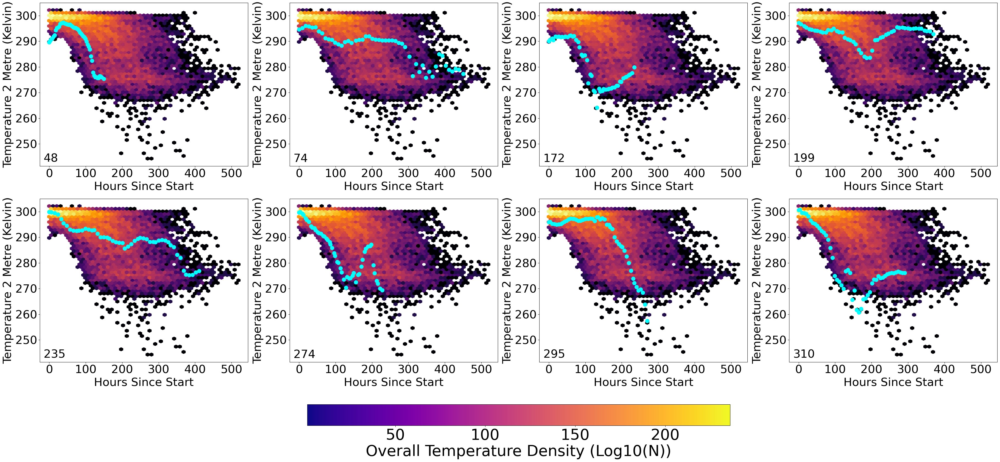

In [50]:
ids = wp_data['SID'].drop_duplicates()

# create figure and axis
fig, ax = plt.subplots(2, 4, figsize=(45, 20))

storms_to_show = [[48, 74, 172, 199], [235, 274, 295, 310]]

for i in range(len(storms_to_show)):
    for j in range(len(storms_to_show[i])):
    
        hb = ax[i, j].hexbin(all_HSS, all_T2M, gridsize=50, cmap='inferno', mincnt=1, bins='log')

        anomalous_index = storms_to_show[i][j]
        anomolous_id = wp_data_flattened[anomalous_index][0]
        
        storm_data = wp_data[wp_data['SID'] == anomolous_id]

        ax[i, j].scatter(storm_data['HSS'], storm_data['T2M'], color='cyan', s=100)
        ax[i, j].set_xlabel('Hours Since Start', fontsize=30)
        ax[i, j].set_ylabel('Temperature 2 Metre (Kelvin)', fontsize=30)
        ax[i, j].tick_params(axis='both', which='major', labelsize=30)

        ax[i, j].text(-15, 243, anomalous_index, fontsize=30)
    
min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.05, pad=0.1)
cbar.set_label('Overall Temperature Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

plt.savefig('new_graphs/ac_temp.png', bbox_inches='tight', pad_inches=1, dpi=300)
plt.show()

# IF

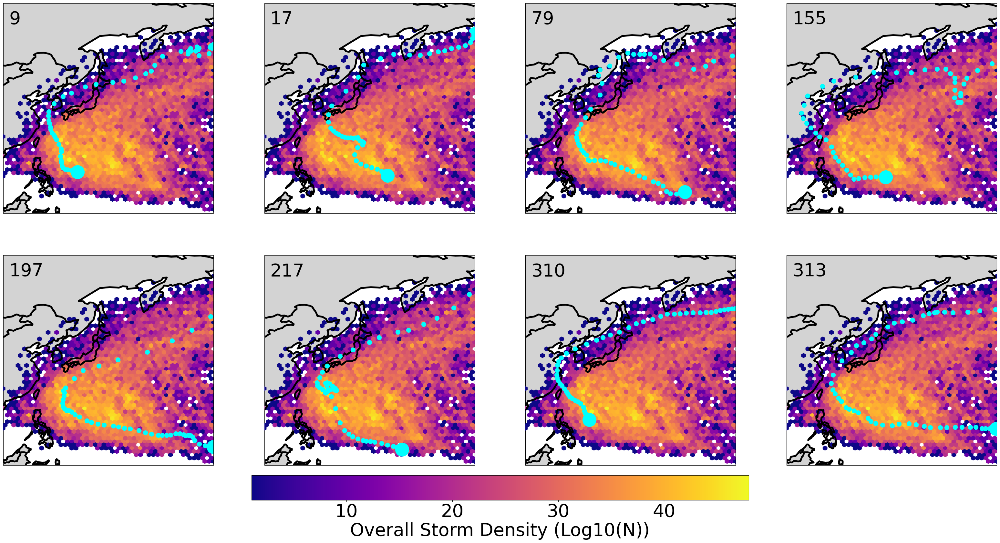

In [51]:
ids = wp_data['SID'].drop_duplicates()

crs = ccrs.PlateCarree()

# create figure and axis
fig, ax = plt.subplots(2, 4, subplot_kw={'projection': crs}, figsize=(40, 20))

storms_to_show = [[9, 17, 79, 155], [197, 217, 310, 313]]

for i in range(len(storms_to_show)):
    for j in range(len(storms_to_show[i])):
        ax[i, j].add_feature(cfeature.LAND, facecolor='lightgray')
        ax[i, j].add_feature(cfeature.COASTLINE, linewidth=4, zorder=10, edgecolor='black')
        ax[i, j].add_feature(cfeature.BORDERS, linewidth=4, zorder=10, edgecolor='black')
        ax[i, j].set_extent([110, 180, 0, 70], crs=crs)   

        hb = ax[i, j].hexbin(all_lons, all_lats, gridsize=50, cmap='plasma', bins='log', mincnt=1, zorder=5)

        anomalous_index = storms_to_show[i][j]
        anomolous_id = wp_data_flattened[anomalous_index][0]

        ax[i, j].text(112, 63, anomalous_index, fontsize=40)

        storm_data = wp_data[wp_data['SID'] == anomolous_id]

        started = False
        
        for _, row in storm_data.iterrows():

            if not started:
                marker_size = 30
                started = True
            else:
                marker_size = 10

            ax[i, j].plot(float(row['LON']), float(row['LAT']), color='cyan', marker='o', alpha=1, markersize=marker_size, zorder=15)

min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.05, pad=0.02)
cbar.set_label('Overall Storm Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

plt.savefig('new_graphs/if_track.png', bbox_inches='tight', pad_inches=1, dpi=300)
plt.show()

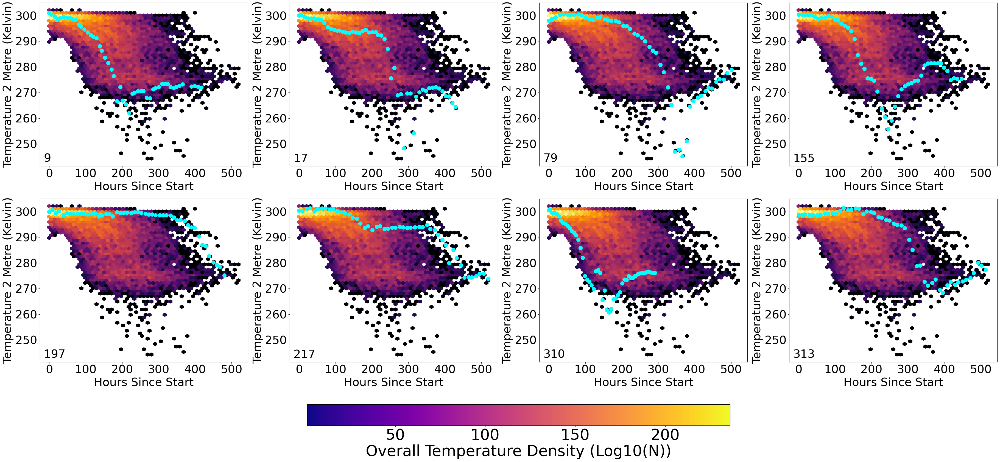

In [52]:
ids = wp_data['SID'].drop_duplicates()

# create figure and axis
fig, ax = plt.subplots(2, 4, figsize=(45, 20))

storms_to_show = [[9, 17, 79, 155], [197, 217, 310, 313]]

for i in range(len(storms_to_show)):
    for j in range(len(storms_to_show[i])):
    
        hb = ax[i, j].hexbin(all_HSS, all_T2M, gridsize=50, cmap='inferno', mincnt=1, bins='log')

        anomalous_index = storms_to_show[i][j]
        anomolous_id = wp_data_flattened[anomalous_index][0]
        
        storm_data = wp_data[wp_data['SID'] == anomolous_id]

        ax[i, j].scatter(storm_data['HSS'], storm_data['T2M'], color='cyan', s=100)
        ax[i, j].set_xlabel('Hours Since Start', fontsize=30)
        ax[i, j].set_ylabel('Temperature 2 Metre (Kelvin)', fontsize=30)
        ax[i, j].tick_params(axis='both', which='major', labelsize=30)

        ax[i, j].text(-15, 243, anomalous_index, fontsize=30)
    
min = hb.get_array().min()
max = hb.get_array().max()
norm = plt.Normalize(vmin=min, vmax=max)
sm = ScalarMappable(cmap='plasma', norm=norm)

# add colourbar
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', fraction=0.05, pad=0.1)
cbar.set_label('Overall Temperature Density (Log10(N))', fontsize=40)
cbar.ax.tick_params(labelsize=40)

plt.savefig('new_graphs/if_temp.png', bbox_inches='tight', pad_inches=1, dpi=300)
plt.show()